<a href="https://colab.research.google.com/github/ranton256/august-ocr/blob/main/DeepSeek_OCR_Quantized_to_4bit.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# DeepSeek 4 bit OCR
Thanks to <https://colab.research.google.com/github/Alireza-Akhavan/LLM/blob/main/deepseek_ocr_inference_4bit.ipynb> for their example for dep versions and quanitzation settings that were working.

### Setup

In [1]:
%pip install -q --no-deps -q bitsandbytes

In [2]:
%pip install -q addict transformers==4.46.3 tokenizers==0.20.3

In [3]:
# This is only needed for download the sample image from Google Drive.
%pip install -q gdown

In [4]:
from transformers import AutoModel, AutoTokenizer, BitsAndBytesConfig
import torch

model_name = 'deepseek-ai/DeepSeek-OCR'

## 4 bit Quantization

The DeepSeek-OCR model is memory intensive, and requires GPUs only available with a colab pro subscription to load successfully, but by quantizing it we can use a T4 runtime.

In [5]:
qc = BitsAndBytesConfig(
    load_in_4bit=True,
    bnb_4bit_use_double_quant=True,
    bnb_4bit_quant_type="nf4",
    bnb_4bit_compute_dtype=torch.float
)

## Fetching the model

Fetching this from Hugging Face Hub will ask you for an API token in HF_TOKEN environment variable to get the model if you don't have one set already.

In [6]:
tokenizer = AutoTokenizer.from_pretrained(model_name, trust_remote_code=True)
model = AutoModel.from_pretrained(
    model_name, trust_remote_code=True,
    use_safetensors=True, device_map="auto",
    quantization_config=qc, torch_dtype=torch.float
)
model = model.eval()

You are using a model of type deepseek_vl_v2 to instantiate a model of type DeepseekOCR. This is not supported for all configurations of models and can yield errors.
Some weights of DeepseekOCRForCausalLM were not initialized from the model checkpoint at deepseek-ai/DeepSeek-OCR and are newly initialized: ['model.vision_model.embeddings.position_ids']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [7]:
prompt = "<image>\n<|grounding|>Convert the document to markdown."
# Prompts examples:
# document: <image>\n<|grounding|>Convert the document to markdown.
# other image: <image>\n<|grounding|>OCR this image.
# without layouts: <image>\nFree OCR.
# figures in document: <image>\nParse the figure.
# general: <image>\nDescribe this image in detail.
# rec: <image>\nLocate <|ref|>xxxx<|/ref|> in the image.

## Choose your input image

In [8]:
# set to True to ask use to upload a file, False to download sample image
ask_for_upload = False

In [9]:
# Ask image to upload an image of their own.
if ask_for_upload:
  from google.colab import files

  uploaded = files.upload()

  for fn in uploaded.keys():
    image_file = "/content/" + fn

  print(f"Using image: {image_file}")

In [10]:
sample_image_url = "https://drive.google.com/file/d/14fpdxO3oSIzKyGLj_aniFC_aZseyQeQf/view?usp=sharing"

In [11]:
# Download an image from publicly available Google Drive file

import gdown
from IPython.display import Image

if not ask_for_upload:
  file_id = sample_image_url.split('/')[-2]
  image_file_name = "downloaded_image.png"
  gdown.download(id=file_id, output=image_file_name, quiet=True)
  image_file = "/content/" + image_file_name


## Show the loaded image.

In [12]:
from PIL import Image
# This seems to make the OCR fail instead of succeed gloriously!

# max_dim = 1024

# with Image.open(image_file) as img:
#     width, height = img.size
#     if max(width, height) > max_dim:
#         if width > height:
#             new_width = max_dim
#             new_height = int(height * (max_dim / width))
#         else:
#             new_height = max_dim
#             new_width = int(width * (max_dim / height))
#         img = img.resize((new_width, new_height), Image.LANCZOS)
#     img.save(image_file) # Overwrite with the resized image

# print(f"Image resized to: {img.size[0]}x{img.size[1]} pixels")


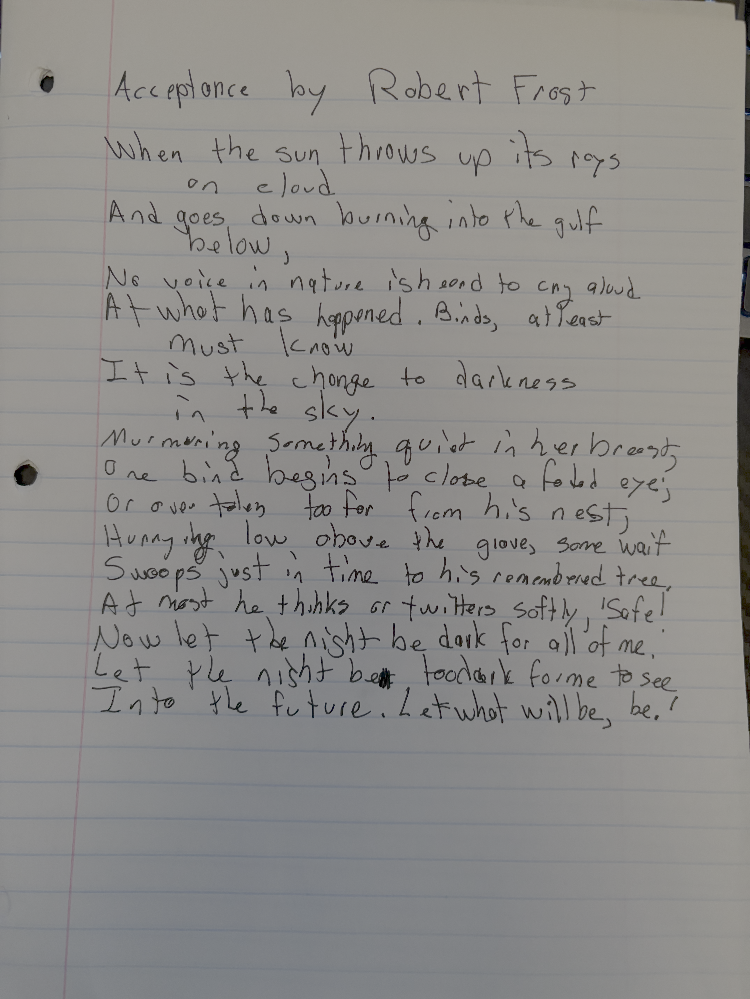

In [13]:
from IPython.display import Image
Image(image_file, width=640)

In [14]:
results = None
with torch.no_grad():
    res = model.infer(
        tokenizer,
        prompt=prompt,
        image_file=image_file,
        output_path=".",
        base_size=1024,
        image_size=1024,
        crop_mode=False,
        save_results=True,
        test_compress=True,
        eval_mode=False
    )
    results = res

/usr/local/lib/python3.12/dist-packages/transformers/generation/configuration_utils.py:590: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.0` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(
The attention mask and the pad token id were not set. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.
Setting `pad_token_id` to `eos_token_id`:None for open-end generation.
The attention mask is not set and cannot be inferred from input because pad token is same as eos token. As a consequence, you may observe unexpected behavior. Please pass your input's `attention_mask` to obtain reliable results.
The `seen_tokens` attribute is deprecated and will be removed in v4.41. Use the `cache_position` model input instead.
`get_max_cache()` is deprecated for all Cache classes. Use `get_max_cache_shape()` instead. Cal

BASE:  torch.Size([1, 256, 1280])
NO PATCHES
<|ref|>text<|/ref|><|det|>[[0, 0, 997, 999]]<|/det|>
Acceptance by Robert Frost

When the sun throws up its rays on a cloud

And goes down burning into the gulf below,

No voice in nature is heard to cry aloud

At what has happened. Birds, at least must know

It is the change to darkness in the sky.

Murmuring something quiet in her breast

One bird begins to close a fold eye

Or over fallen too far from his nest

Hungry, low above the gives some wait

Sweeps just in time to his remembered tree

At most he thinks or writers softly, 'Safe!

Now let the night be dark for all of me,

Let the night be foodark for me to see

Into the future. Let what will be, be
image size:  (4284, 5712)
valid image tokens:  192
output texts tokens (valid):  169
compression ratio:  0.88
===============save results:===============


image: 0it [00:00, ?it/s]
other: 100%|██████████| 1/1 [00:00<00:00, 14463.12it/s]


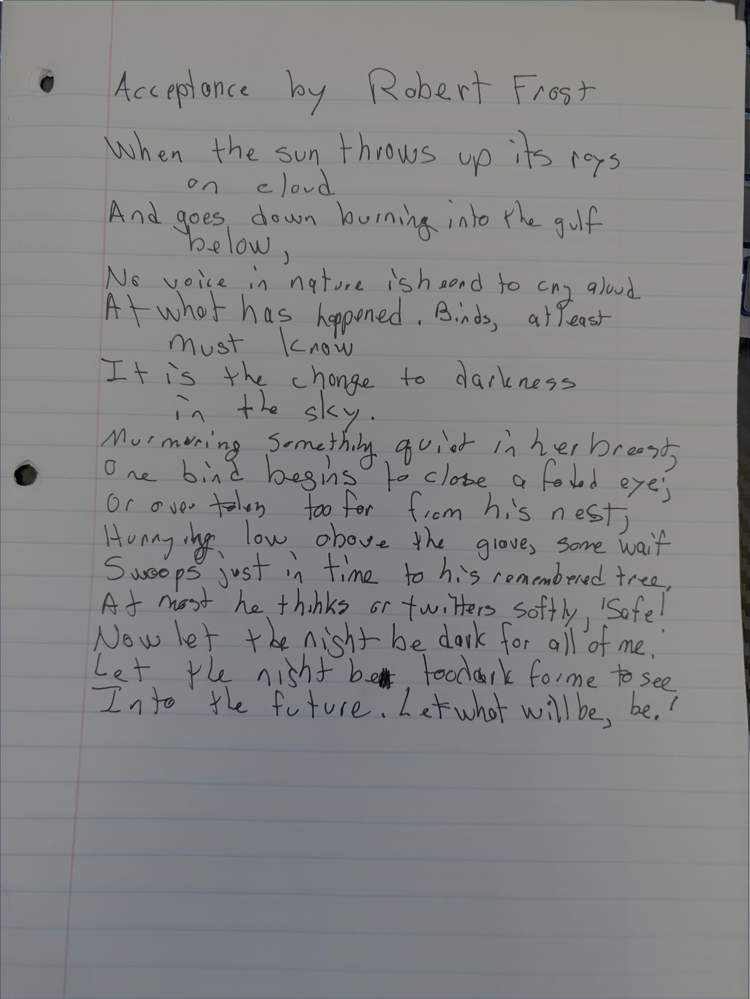

In [15]:
Image("result_with_boxes.jpg", width=640)

In [16]:
from IPython.display import Markdown
contents = None
with open("result.mmd") as f:
  contents = f.read()

Markdown(contents)



Acceptance by Robert Frost

When the sun throws up its rays on a cloud

And goes down burning into the gulf below,

No voice in nature is heard to cry aloud

At what has happened. Birds, at least must know

It is the change to darkness in the sky.

Murmuring something quiet in her breast

One bird begins to close a fold eye

Or over fallen too far from his nest

Hungry, low above the gives some wait

Sweeps just in time to his remembered tree

At most he thinks or writers softly, 'Safe!

Now let the night be dark for all of me,

Let the night be foodark for me to see

Into the future. Let what will be, be